<a href="https://colab.research.google.com/github/SHREERAJ11/DL-Simplified/blob/main/Roadmark%20Detection/Datasets/Understanding_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install kaggle

In [ ]:
!mkdir ~/.kaggle

In [ ]:
!cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
! kaggle datasets download pkdarabi/road-mark-detection

Dataset URL: https://www.kaggle.com/datasets/pkdarabi/road-mark-detection
License(s): Attribution 4.0 International (CC BY 4.0)
 84% 135M/161M [00:00<00:00, 245MB/s]
100% 161M/161M [00:00<00:00, 236MB/s]


In [ ]:
! unzip road-mark-detection.zip

Streaming output truncated to the last 5000 lines.
  inflating: train/images/161b_jpg.rf.85f842102d7d7c6a3a8f9c93529c75b2.jpg  
  inflating: train/images/162a_jpg.rf.03425938f4f2d24be2e6c8a1686402ac.jpg  
  inflating: train/images/162b_jpg.rf.f9cad32427fe31938c0c0a01a4f47d4f.jpg  
  inflating: train/images/162c_jpg.rf.25bb41e5d59ec73f2db179022e1a9495.jpg  
  inflating: train/images/162d_jpg.rf.1fc78c1c28e08d111a29be67e80acd07.jpg  
  inflating: train/images/163_jpg.rf.6d8b5b078a7941ca338aa7019e8ec146.jpg  
  inflating: train/images/163b_jpg.rf.ae02ecd22abc81561cdc0397ef47a52c.jpg  
  inflating: train/images/164_jpg.rf.dd2ab2f31ab71fa5fbe6767d50a01a2c.jpg  
  inflating: train/images/165_jpg.rf.7a7719222c9d36709a26d63ee4df3567.jpg  
  inflating: train/images/165a_jpg.rf.a5c17a8f88f8d89629b569c341792808.jpg  
  inflating: train/images/165b_jpg.rf.f34b30ab4021c291d53f991b5c29a986.jpg  
  inflating: train/images/165d_jpg.rf.e3f350bc04c489fd5f5f1d714c152032.jpg  
  inflating: train/images/16

In [ ]:
# Importing initial required libraries
import os
import cv2
import numpy as np

In [ ]:
# Define the data directories
train_dir = '/content/train'
valid_dir = '/content/valid'
test_dir = '/content/test'

In [ ]:
# Function to load images and their corresponding labels
def load_images_and_labels(directory):
    images = []
    labels = []
    image_files = os.listdir(os.path.join(directory, 'images'))
    label_files = os.listdir(os.path.join(directory, 'labels'))
    for image_file in image_files:
        if image_file.endswith('.jpg'):
            img_path = os.path.join(directory, 'images', image_file)
            img = cv2.imread(img_path)
            if img is None:
                print(f'Failed to load image at path: {img_path}')
                continue
            label_file = image_file.replace('.jpg', '.txt')
            if label_file in label_files:
                label_path = os.path.join(directory, 'labels', label_file)
                with open(label_path, 'r') as f:
                    label = f.read().strip()
                    images.append(img)
                    labels.append(label)
    return np.array(images), np.array(labels)

In [ ]:
# Load the images and labels
train_images, train_labels = load_images_and_labels(train_dir)
valid_images, valid_labels = load_images_and_labels(valid_dir)
test_images, test_labels = load_images_and_labels(test_dir)

In [ ]:
import matplotlib.pyplot as plt

Following code code will print the shape of images and labels, the number of unique labels, and the distribution of labels in the training set.

In [ ]:
# Printing the shape of the data
print('Train images shape:', train_images.shape)
print('Train labels shape:', train_labels.shape)
print('Valid images shape:', valid_images.shape)
print('Valid labels shape:', valid_labels.shape)
print('Test images shape:', test_images.shape)
print('Test labels shape:', test_labels.shape)

Train images shape: (2167, 640, 640, 3)
Train labels shape: (2167,)
Valid images shape: (417, 640, 640, 3)
Valid labels shape: (417,)
Test images shape: (192, 640, 640, 3)
Test labels shape: (192,)


In [ ]:
# Print the number of unique labels
print('Number of unique labels:', len(np.unique(train_labels)))

Number of unique labels: 2167


In [ ]:
# Print the distribution of labels in the training set
unique, counts = np.unique(train_labels, return_counts=True)
print('Distribution of labels in the training set:', dict(zip(unique, counts)))

Distribution of labels in the training set: {'0 0 0.777971221875 0.12019230781250001 0.8360042734375 0.2690304484375 0.778133903125 0.1603565703125 0.7514245015625 0 0.7777121 0 0.777971221875': 1, '0 0.0033703703125 0.77614375 0.0502453703125 0.8066453125 0.11090648125 0.8311546875 0.1755518515625 0.8061 0.23682592656249998 0.773965625 0.146446296875 0.7505453125 0.0033703703125 0.77614375\n2 0.740621296875 0.9710890624999999 0.54826944375 0.7248546874999999 0.543528703125 0.7272640625 0.7226731484375 0.9728953125 0.740621296875 0.9710890624999999\n2 0.37488240781250004 0.9343656250000001 0.43685462968750005 0.8115484374999999 0.4544648140625 0.7700078125 0.45480277812500003 0.7615796875 0.42872685156249996 0.8067328125 0.3593046296875 0.932559375 0.37488240781250004 0.9343656250000001\n2 0.1388453703125 0.8278046874999999 0 0.8723546875 0.0023703703125 0.892825 0.14934351875000001 0.8380390625 0.31561944375 0.76579375 0.408747221875 0.72124375 0.39960370312500004 0.7188343749999999 0

**Data Exploration**

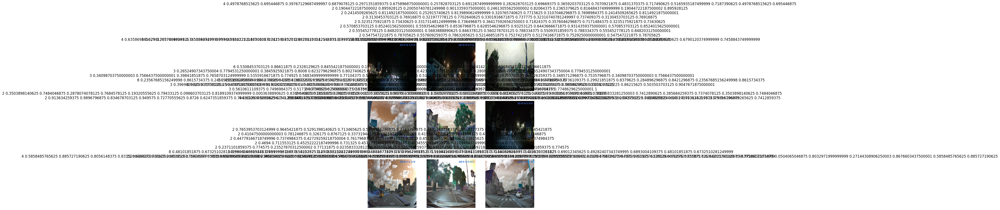

In [ ]:
# Display some images from the training set
plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(train_images[i])
    plt.title(train_labels[i])
    plt.axis("off")

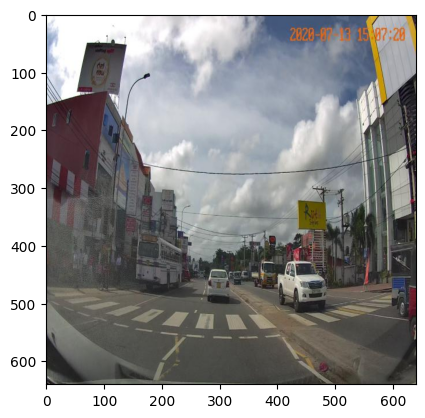

In [ ]:
plt.imshow(cv2.cvtColor(train_images[i], cv2.COLOR_BGR2RGB))

Check for Color Distribution on a random image

In [ ]:
from skimage import io, color

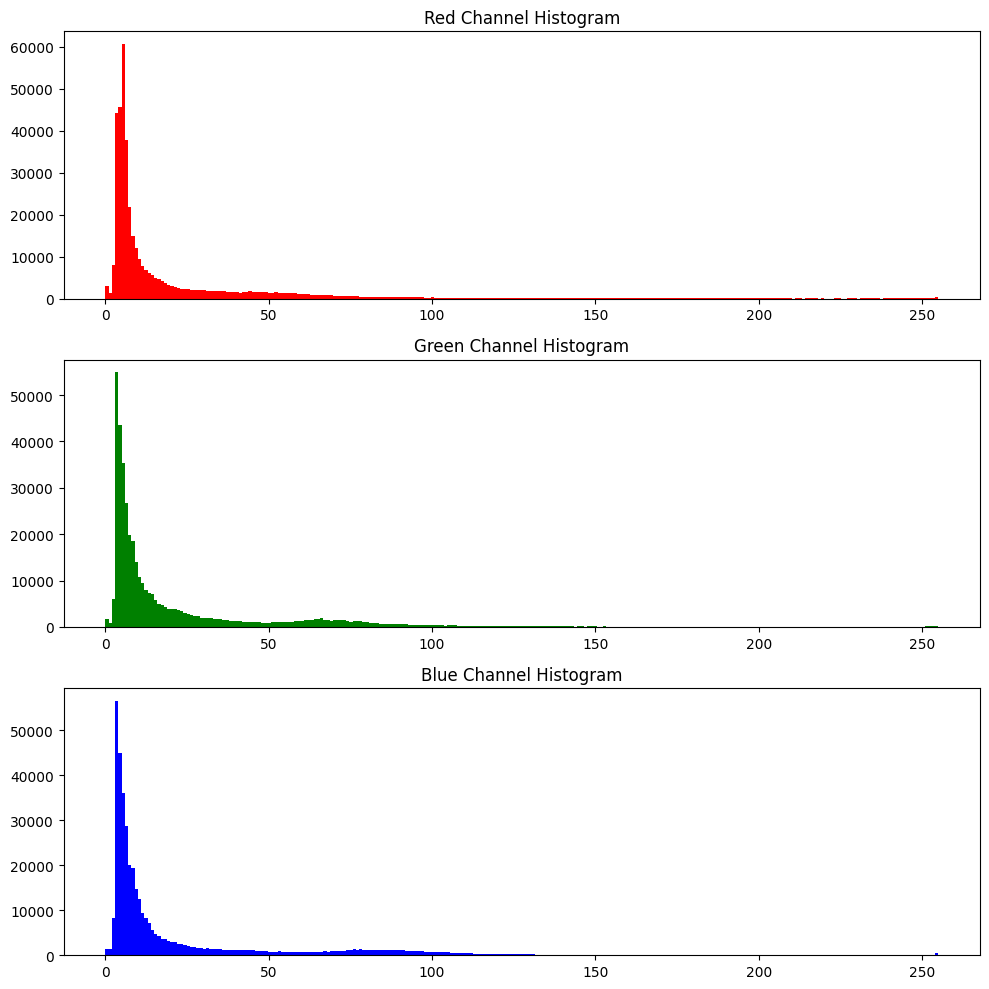

In [ ]:
# Analyze color distribution of the first image in the training set
image = train_images[0]
red_channel = image[:, :, 0]
green_channel = image[:, :, 1]
blue_channel = image[:, :, 2]

plt.figure(figsize=(10, 10))

plt.subplot(3, 1, 1)
plt.hist(red_channel.ravel(), bins=256, color='red')
plt.title('Red Channel Histogram')

plt.subplot(3, 1, 2)
plt.hist(green_channel.ravel(), bins=256, color='green')
plt.title('Green Channel Histogram')

plt.subplot(3, 1, 3)
plt.hist(blue_channel.ravel(), bins=256, color='blue')
plt.title('Blue Channel Histogram')

plt.tight_layout()
plt.show()

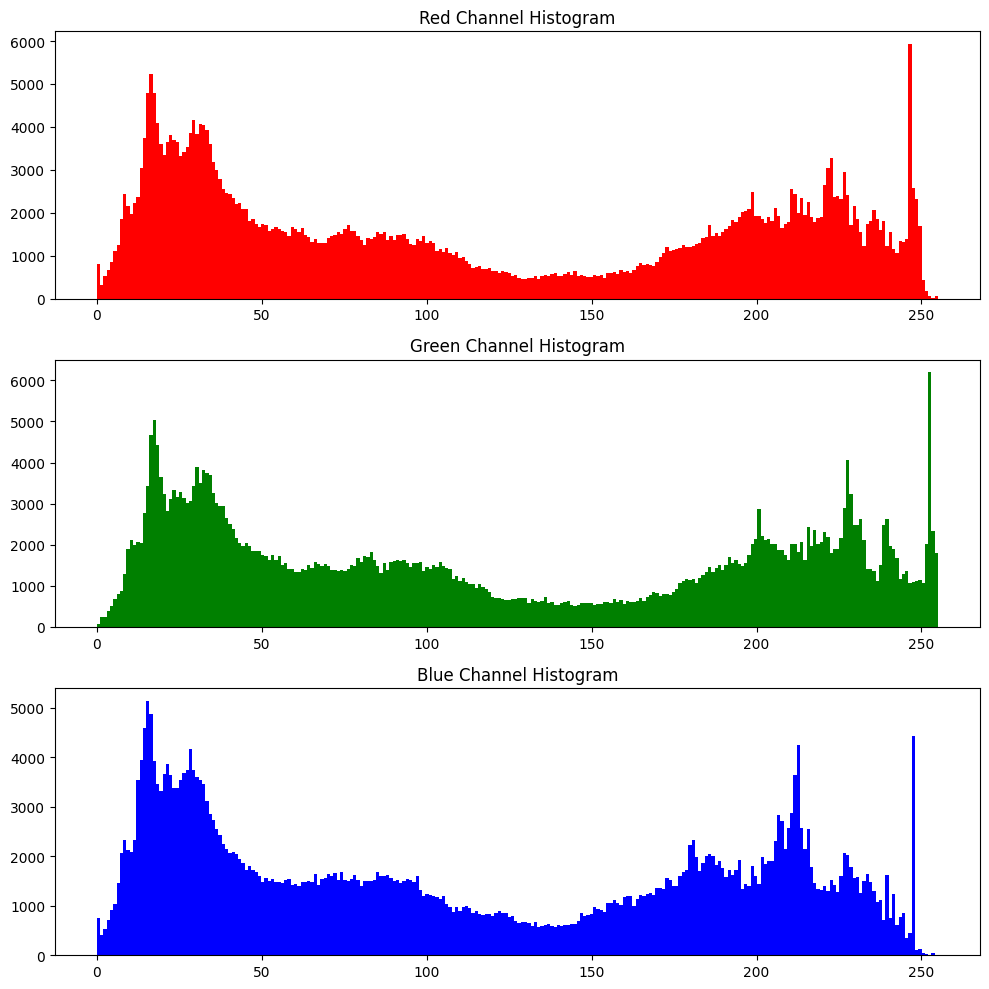

In [ ]:
# Analyze color distribution of the third image in the training set
image = train_images[2]
red_channel = image[:, :, 0]
green_channel = image[:, :, 1]
blue_channel = image[:, :, 2]

plt.figure(figsize=(10, 10))

plt.subplot(3, 1, 1)
plt.hist(red_channel.ravel(), bins=256, color='red')
plt.title('Red Channel Histogram')

plt.subplot(3, 1, 2)
plt.hist(green_channel.ravel(), bins=256, color='green')
plt.title('Green Channel Histogram')

plt.subplot(3, 1, 3)
plt.hist(blue_channel.ravel(), bins=256, color='blue')
plt.title('Blue Channel Histogram')

plt.tight_layout()
plt.show()

Understand label distribution

In [ ]:
import seaborn as sns

In [ ]:
# Convert labels to numpy array for convenience
train_labels_np = np.array(train_labels)
valid_labels_np = np.array(valid_labels)
test_labels_np = np.array(test_labels)

In [ ]:
# Get unique labels and their counts in the training set
unique_train_labels, counts_train_labels = np.unique(train_labels_np, return_counts=True)

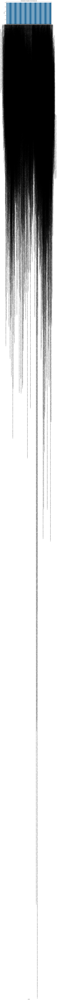

In [ ]:
# Plot the distribution of labels in the training set
plt.figure(figsize=(12, 6))
sns.barplot(x=unique_train_labels, y=counts_train_labels)
plt.title('Distribution of Labels in the Training Set')
plt.xlabel('Labels')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()

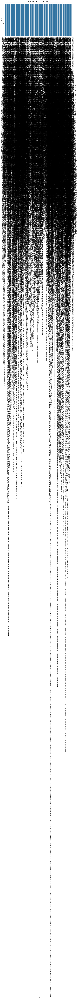

In [ ]:
# Validation set
unique_valid_labels, counts_valid_labels = np.unique(valid_labels_np, return_counts=True)
plt.figure(figsize=(12, 6))
sns.barplot(x=unique_valid_labels, y=counts_valid_labels)
plt.title('Distribution of Labels in the Validation Set')
plt.xlabel('Labels')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()

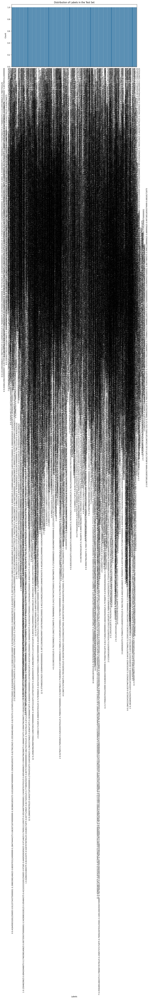

In [ ]:
# Test set
unique_test_labels, counts_test_labels = np.unique(test_labels_np, return_counts=True)
plt.figure(figsize=(12, 6))
sns.barplot(x=unique_test_labels, y=counts_test_labels)
plt.title('Distribution of Labels in the Test Set')
plt.xlabel('Labels')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()